
fc1.weight (Matrix):
[[-0.000753097236156 -0.006431056186557 0.009222310967743
  -0.010310356505215 -0.017468422651291 -0.003900666022673
  0.014636415056884 -0.009567510336637 -0.004808496683836
  0.009773734956980 0.013164461590350 0.020552244037390
  -0.009543164633214 0.008351190015674 0.004898666404188
  -0.007150711026043 -0.008947039954364 -0.009248669259250
  0.012480834499002 -0.013747116550803 -0.018421880900860
  0.017408691346645 -0.018792940303683 -0.015674507245421
  -0.013451883569360 0.019274909049273 0.012910610996187
  0.020477401092649 0.007605113554746 -0.008575557731092
  0.007672967854887 0.011859622783959 0.013648619875312 0.014492285437882
  0.020050106570125 0.058406285941601 -0.005038130097091
  -0.020232757553458 -0.013983791694045 -0.013795291073620
  0.010750396177173 0.001749520655721 -0.008350347168744
  0.019792195409536 0.108835726976395 0.041005473583937
  -0.002612265991047 -0.112309969961643 -0.112536959350109
  0.007161743938923 -0.161829158663750 

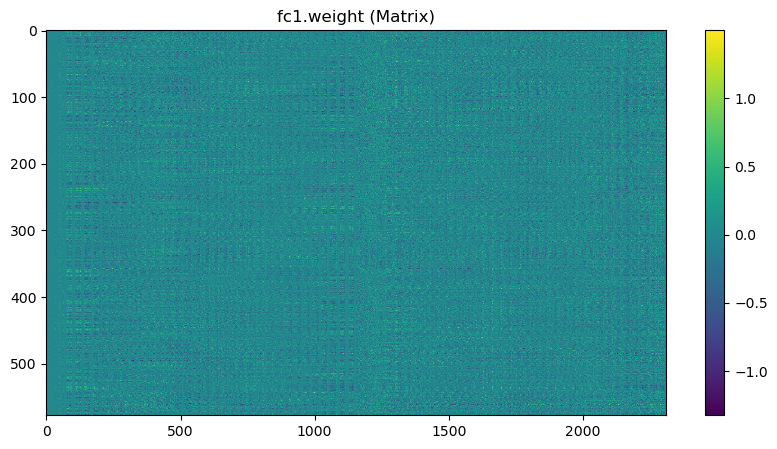

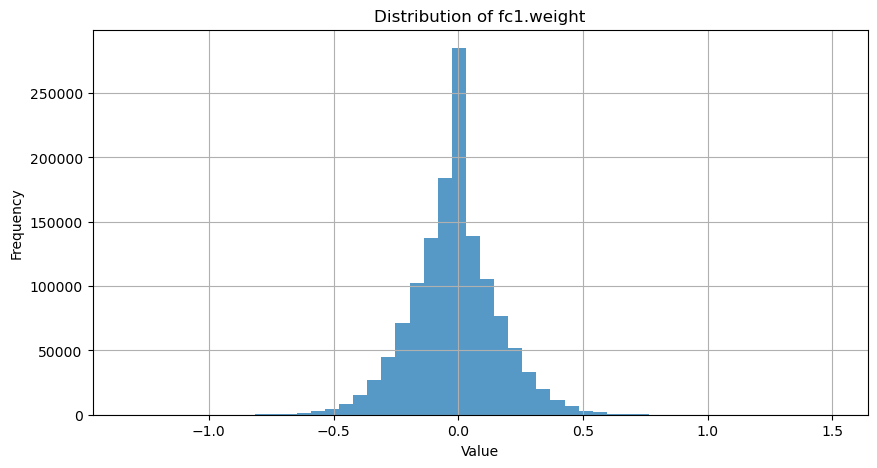


fc1.bias (Vector):
[-0.082349941134453 -0.035171851515770 -0.066176541149616
 -0.027283955365419 0.003320561721921 -0.050992976874113 0.191971480846405
 0.148552373051643 0.000502341135871 0.044935189187527 0.158156856894493
 -0.094190947711468 0.314562648534775 0.102381661534309 0.010216873139143
 0.016552338376641 0.066134154796600 -0.077609449625015 -0.013493224978447
 0.093642733991146 -0.071862883865833 -0.019014602527022 0.014918973669410
 -0.016408363357186 0.013060174882412 -0.021569043397903 0.074764430522919
 -0.056223351508379 0.037223104387522 -0.055309265851974 0.165245652198792
 0.082946538925171 0.143200784921646 -0.103715054690838 -0.049035206437111
 0.127520486712456 0.072493351995945 -0.038409594446421 0.039694651961327
 0.106575176119804 0.084703370928764 0.166136041283607 -0.067318022251129
 -0.061638668179512 -0.021371170878410 0.150098294019699 0.005187509115785
 0.034852471202612 -0.040137197822332 0.075377359986305 0.015846654772758
 0.155535399913788 0.0305238

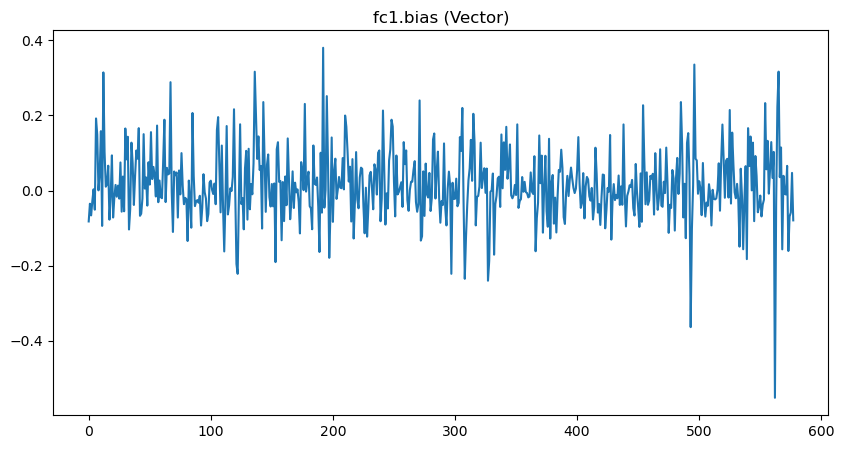

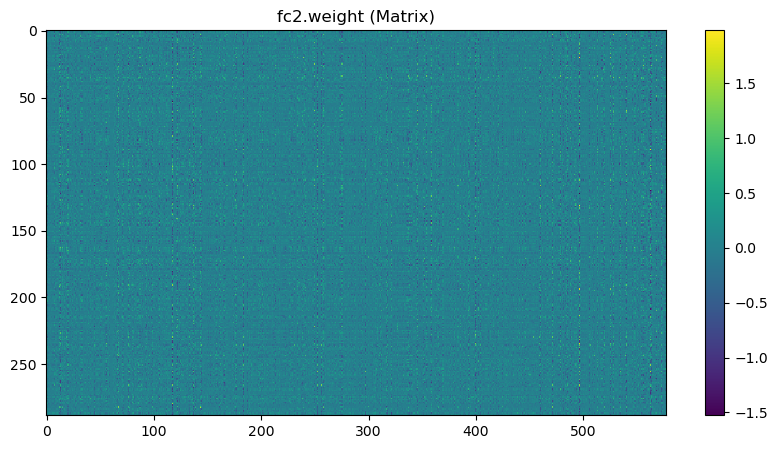

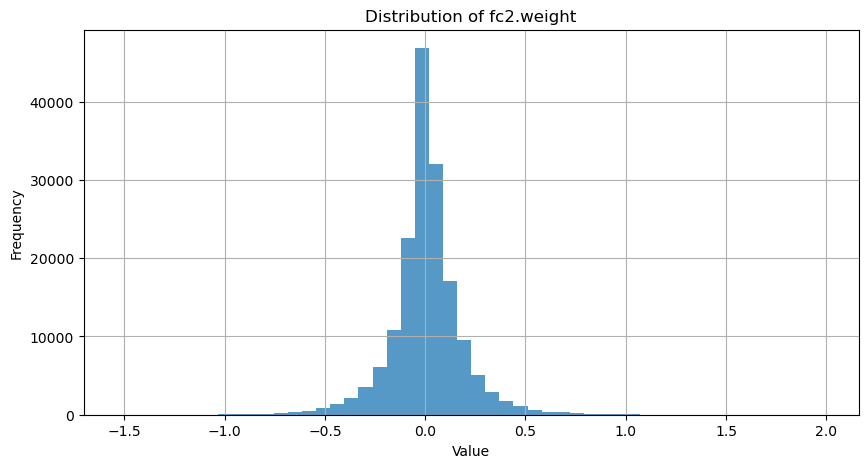


fc2.bias (Vector):
[0.207722648978233 0.249294117093086 -0.006375347264111 -0.026646658778191
 0.090994484722614 0.165562748908997 0.003449594834819 0.116654545068741
 0.031382583081722 -0.072786100208759 -0.147047549486160 0.028876546770334
 0.021043198183179 0.013779252767563 0.053087253123522 -0.072400704026222
 0.035054709762335 -0.103661485016346 0.066174790263176 0.198353394865990
 -0.042649660259485 0.111702866852283 0.010316674597561 0.158587560057640
 -0.073352977633476 -0.048126641660929 0.116218753159046
 -0.031860452145338 0.047844376415014 0.046844497323036 -0.070833653211594
 0.070651128888130 -0.060409288853407 0.148719370365143 -0.029280906543136
 0.018867056816816 0.107149638235569 0.055269736796618 0.072677768766880
 -0.040981210768223 -0.091239102184772 0.109560228884220 0.081013351678848
 -0.006603764835745 -0.021706392988563 0.091868482530117 0.020082468166947
 0.134787827730179 0.051431104540825 0.050082206726074 0.072624728083611
 -0.042952809482813 0.0595673732

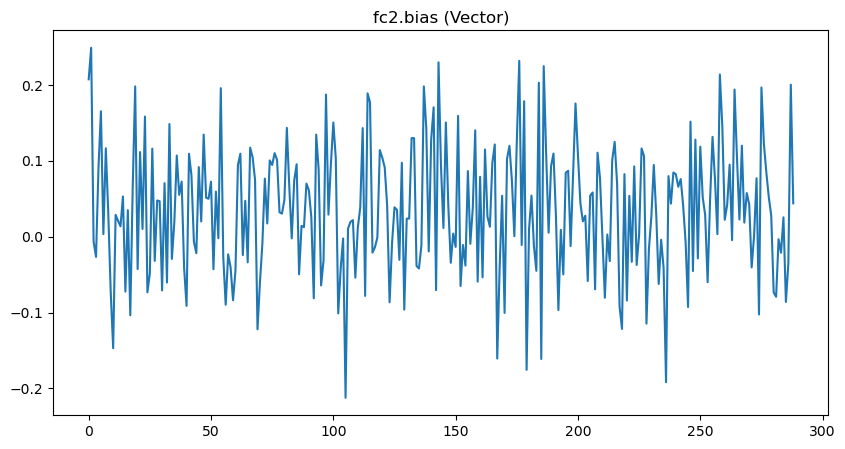

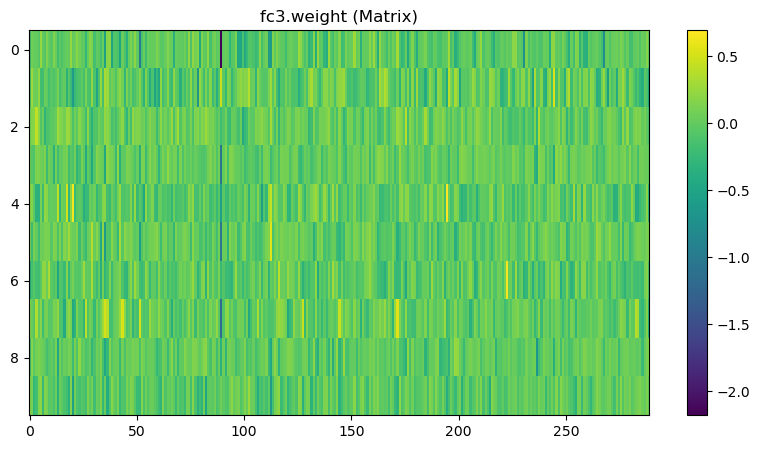

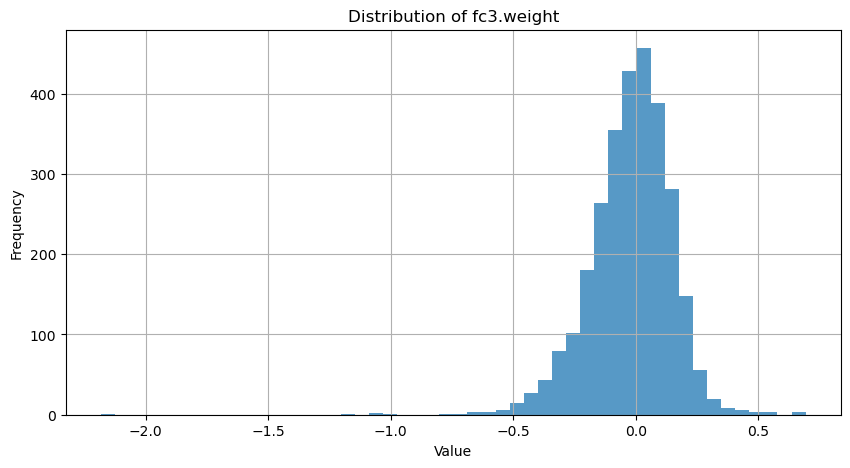


fc3.bias (Vector):
[0.009488061070442 0.269201427698135 0.165523886680603 0.088667452335358
 0.147066190838814 0.145730823278427 0.100368075072765 0.071318648755550
 0.117506071925163 0.084163933992386]


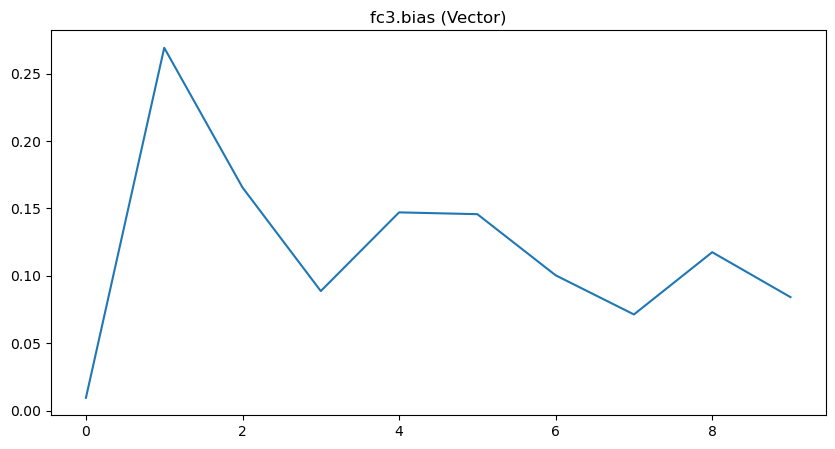

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import os

# Define the path to the directory containing the binary files and metadata
directory = "/home/copparihollmann/neuroTUM/fix/SpikingCpp/models/SNN_3L_simple_LIF_NMNIST/weights_and_bias_binary"

# Metadata for shapes and data types
metadata = {
    "fc1.weight": {"shape": (578, 2312), "dtype": np.float32},
    "fc1.bias": {"shape": (578,), "dtype": np.float32},
    "fc2.weight": {"shape": (289, 578), "dtype": np.float32},
    "fc2.bias": {"shape": (289,), "dtype": np.float32},
    "fc3.weight": {"shape": (10, 289), "dtype": np.float32},
    "fc3.bias": {"shape": (10,), "dtype": np.float32}
}

def read_and_reshape(filename, shape, dtype):
    """Read a binary file and reshape it according to the provided shape."""
    with open(filename, 'rb') as f:
        data = np.fromfile(f, dtype=dtype)
    return data.reshape(shape)

def plot_data(data, title):
    """Plot the data as an image and print the matrix or vector."""
    plt.figure(figsize=(10, 5))
    if data.ndim == 1:
        # If the data is a vector, plot as a line
        plt.plot(data)
        plt.title(title + " (Vector)")
        print(f"\n{title} (Vector):")
        with np.printoptions(threshold=np.inf, suppress=True, formatter={'float_kind':'{:.15f}'.format}):
            print(data)
    else:
        # If the data is a matrix, plot as a heatmap
        plt.imshow(data, aspect='auto', interpolation='nearest')
        plt.colorbar()
        plt.title(title + " (Matrix)")
        #print(f"\n{title} (Matrix):")
        #print(data)
        
        with np.printoptions(threshold=np.inf, suppress=True, formatter={'float_kind':'{:.15f}'.format}):
            print(f"\n{title} (Matrix):")
            print(data)

    # Plot the distribution if it's a weight matrix
    if "weight" in title:
        plt.figure(figsize=(10, 5))
        plt.hist(data.flatten(), bins=50, alpha=0.75)
        plt.title(f"Distribution of {title}")
        plt.xlabel('Value')
        plt.ylabel('Frequency')
        plt.grid(True)
        plt.show()

# Process each item in metadata to read, reshape, plot, and print
for key, info in metadata.items():
    filename = os.path.join(directory, key.replace('.', '_') + '.bin')
    data = read_and_reshape(filename, info['shape'], info['dtype'])
    plot_data(data, key)
